# **Graded Challenge 7 - Computer Vision**
---

# **Introduction**

Name: Basyira Sabita  
Batch: HCK-012

**Objectives**  
This program aims to build a Convolutional Neural Network (CNN) model to predict 5 types of flower classification (Lily, Lotus, Orchid, Sunflower, and Tulip). There are two models thats build in this program: the base CNN and the improved base CNN model. Metrics used to evaluate the model is accuracy.

# **Import Libraries** 

In [1]:
# Define Libraries

import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from PIL import Image
import warnings

pd.options.display.max_columns = 200
warnings.filterwarnings('ignore')

# Feature Engineering
from sklearn.model_selection import train_test_split

# Model Evaluation
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

# **Data Loading** 

In [7]:
# Downloading the data from kaggle

# ! mkdir ~/.kaggle
# ! cp './kaggle.json' ~/.kaggle/
# ! chmod 600 '/Users/basyirasabita/.kaggle/kaggle.json'
# ! kaggle datasets download kausthubkannan/5-flower-types-classification-dataset
# ! unzip -q /Users/basyirasabita/github-classroom/FTDS-assignment-bay/p2-ftds012-hck-g7-basyirasabita/5-flower-types-classification-dataset.zip

In [2]:
# Loading the files path
files = glob.glob('./flower_images/*')

files

['./flower_images/Lotus',
 './flower_images/Tulip',
 './flower_images/Orchid',
 './flower_images/Lilly',
 './flower_images/Sunflower']

We observes that there are 5 types of flowers as seen in the flower_images directory.

In [3]:
# Defining the labels for classification
labels = []
for folder in files:
    label = folder.split('/')[2] # Split the path and slice the label name
    labels.append(label)

# Rename Lilly label to Lily
idx_lily = labels.index('Lilly')
labels[idx_lily] = 'Lily'

labels

['Lotus', 'Tulip', 'Orchid', 'Lily', 'Sunflower']

Now, we have list of the label names derived from the directory.

In [4]:
# Rename Lilly label to Lily
os.rename('./flower_images/Lilly', './flower_images/Lily')

As we can see, there's a typo within the lily label. Therefore, we rename it to correct it.

In [11]:
# # Renaming the files by relevant labels
# for label in labels:
#     path = f'./flower_images/{label}'
#     img_files = glob.glob(path + '/*')
#     num = 1
#     for img_file in img_files:
#       os.rename(img_file, f'{path}/{label}_' + "{:03d}".format(num) + '.jpg')
#       num += 1
#     print(f'last num of {label}: {num}')

last num of Lotus: 1001
last num of Tulip: 1001
last num of Orchid: 1001
last num of Lily: 1001
last num of Sunflower: 1001


The images files is now rename based on their labels. So that the name of the files is more descriptive.

In [5]:
# Listing images of each category
files_dict = {}
all_files = []

for label in labels:
    path = f'./flower_images/{label}/*'
    img_files = glob.glob(path)
    img_files.sort()
    files_dict[f'{label}_files'] = img_files
    all_files.extend(img_files)

print(f'len all files: {len(all_files)}')
print(all_files[-6:])

len all files: 5000
['./flower_images/Sunflower/Sunflower_994.jpg', './flower_images/Sunflower/Sunflower_995.jpg', './flower_images/Sunflower/Sunflower_996.jpg', './flower_images/Sunflower/Sunflower_997.jpg', './flower_images/Sunflower/Sunflower_998.jpg', './flower_images/Sunflower/Sunflower_999.jpg']


Now, we're saving all of the files path as a dictionary.

In [6]:
# Create a Pandas DataFrame that contains the path of all images
all_labels = []
for label in labels:
    files = files_dict[f'{label}_files']
    temp = [f'{label}' for i in range(len(files))]
    all_labels.extend(temp)

img_df = pd.DataFrame({
    'images':all_files, 'label':all_labels
})

img_df

,images,label
0,./flower_images/Lotus/Lotus_001.jpg,Lotus
1,./flower_images/Lotus/Lotus_002.jpg,Lotus
2,./flower_images/Lotus/Lotus_003.jpg,Lotus
3,./flower_images/Lotus/Lotus_004.jpg,Lotus
4,./flower_images/Lotus/Lotus_005.jpg,Lotus
...,...,...
4995,./flower_images/Sunflower/Sunflower_995.jpg,Sunflower
4996,./flower_images/Sunflower/Sunflower_996.jpg,Sunflower
4997,./flower_images/Sunflower/Sunflower_997.jpg,Sunflower
4998,./flower_images/Sunflower/Sunflower_998.jpg,Sunflower


Now, we successfully save the path and its corresponding label into img_df.

# **Exploratory Data Analysis** 

## EDA Functions

In [7]:
# Function to plot numeric distribution (histogram & boxplot)
def plot_distribution(df, col, colName, color = 'indianred'):
    plt.figure(figsize=(12,5))

    # Plot Histogram
    plt.subplot(1, 2, 1)
    sns.histplot(data=df[col], kde=True, color=color, bins=20)
    plt.title('Histogram')

    # Boxplot
    plt.subplot(1, 2, 2)
    sns.boxplot(data=df, x=col, color=color)
    plt.title('Boxplot')

    plt.suptitle(f'{colName} Distribution')
    plt.show()

In [8]:
# Function to get the label and its count
def label_proportion(df):
    label_count = df.groupby('label')['label'].count().sort_values(ascending=False)

    labels = label_count.index.to_list()
    counts = label_count.to_list()

    return labels, counts

## Label Proportion

In [9]:
# Get label proportion of image dataframe
labels, counts = label_proportion(img_df)

# Save the label and counts into Dataframe
label_df = pd.DataFrame({
    'label': labels,
    'count': counts
})

label_df

,label,count
0,Lily,1000
1,Lotus,1000
2,Orchid,1000
3,Sunflower,1000
4,Tulip,1000


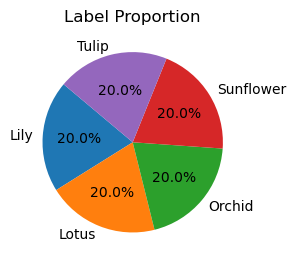

In [10]:
# Piechart
plt.subplot(1, 2, 2)
plt.pie(label_df['count'], labels=labels, autopct='%1.1f%%', startangle=140)
plt.title('Label Proportion')

plt.show()

We can see that each label accounts for 20% of the total. We observe that the data has balanced label counts. Since the label proportions are balanced, we can use accuracy as the metric.

## Image Sizes

In [11]:
# Get all file size in kb
all_file_sizes = []
for label in labels:
    files = files_dict[f'{label}_files']

    for i in range(len(files)):
        temp_path = files[i]
        size = os.path.getsize(temp_path) / 1024 # bytes to kb
        all_file_sizes.append(round(size,3))

# Save the file sizes to the image dataframe
img_df['size_kb'] = all_file_sizes

img_df

,images,label,size_kb
0,./flower_images/Lotus/Lotus_001.jpg,Lotus,33.908
1,./flower_images/Lotus/Lotus_002.jpg,Lotus,11.568
2,./flower_images/Lotus/Lotus_003.jpg,Lotus,51.821
3,./flower_images/Lotus/Lotus_004.jpg,Lotus,6.453
4,./flower_images/Lotus/Lotus_005.jpg,Lotus,176.365
...,...,...,...
4995,./flower_images/Sunflower/Sunflower_995.jpg,Sunflower,10.882
4996,./flower_images/Sunflower/Sunflower_996.jpg,Sunflower,7.918
4997,./flower_images/Sunflower/Sunflower_997.jpg,Sunflower,11.105
4998,./flower_images/Sunflower/Sunflower_998.jpg,Sunflower,9.166


We've successfully saved the sizes of each image in the dataframe.

In [12]:
# Describing the size columns
img_df.describe()

,size_kb
count,5000.000000
mean,51.075335
std,126.097016
min,2.936000
25%,10.431500
50%,15.441000
75%,41.117750
max,3426.434000


We observe that the average size of all the images is 51.075 kb. The maximum size of all the images is 3426.434 kb, and the minimum size of all images is 2.936 kb. The difference between the maximum and minimum sizes is quite extensive. Therefore, we need to see the differences between the small and large images.

### Image Sizes Distribution

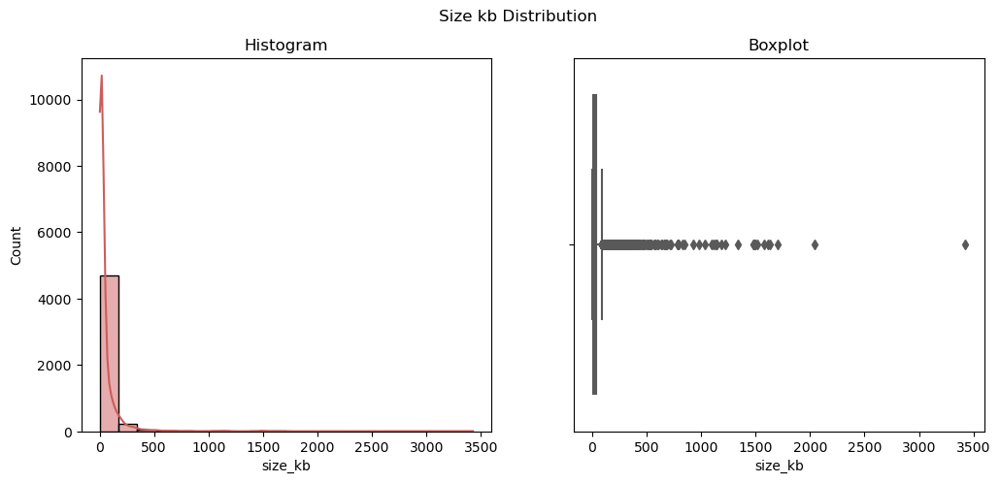

In [13]:
plot_distribution(img_df, 'size_kb', 'Size kb')

As seen in the visualization, the size of the images follows a skewed distribution, with several images having significantly larger sizes compared to the overall distribution. The majority of images fall within a size range lower than 500 kb.

### Display Small Images

In [14]:
small_img_df = img_df[img_df['size_kb'] <= 5]
small_img_df = small_img_df.sample(len(small_img_df)).reset_index(drop=True).head(10)

small_img_df

,images,label,size_kb
0,./flower_images/Tulip/Tulip_387.jpg,Tulip,3.952
1,./flower_images/Sunflower/Sunflower_422.jpg,Sunflower,4.408
2,./flower_images/Sunflower/Sunflower_876.jpg,Sunflower,4.955
3,./flower_images/Lotus/Lotus_227.jpg,Lotus,3.589
4,./flower_images/Sunflower/Sunflower_681.jpg,Sunflower,2.936
5,./flower_images/Sunflower/Sunflower_130.jpg,Sunflower,4.550
6,./flower_images/Tulip/Tulip_265.jpg,Tulip,4.466
7,./flower_images/Sunflower/Sunflower_644.jpg,Sunflower,3.498
8,./flower_images/Sunflower/Sunflower_456.jpg,Sunflower,3.028
9,./flower_images/Sunflower/Sunflower_934.jpg,Sunflower,4.543


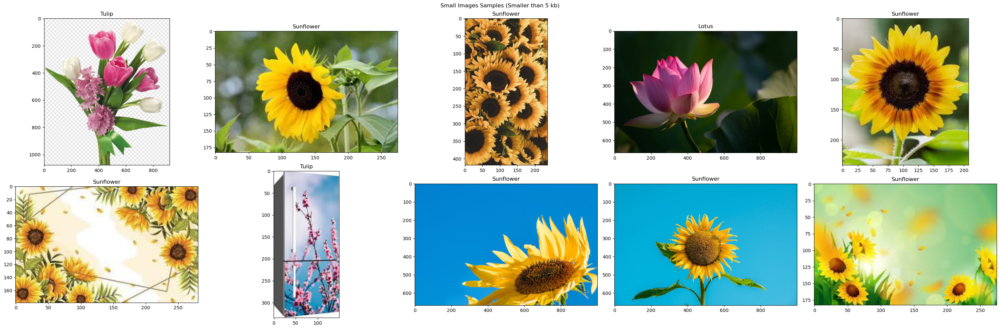

In [15]:
# Define the subplots for displaying images
fig, axes = plt.subplots(ncols=5, nrows= 2, figsize=(30,10))

# Saving the data to list
small_files = small_img_df['images'].to_list()
small_file_labels = small_img_df['label'].to_list()

# Iterate for every axes
idx = 0 # index to access the images and the label
for i in range(2):
    for j in range(5):
        img = plt.imread(small_files[idx])
        axes[i, j].imshow(img)
        axes[i, j].set_title(small_file_labels[idx])
        idx += 1

# Property of the plots
fig.suptitle('Small Images Samples (Smaller than 5 kb)')
fig.tight_layout()
plt.show()

We can see that there are no specific characteristics evident in the small images. From this, we can infer that the smaller size simply indicates lower resolution rather than any particular distinct features.

### Display Large Images

In [25]:
large_img_df = img_df[img_df['size_kb'] >= 1500]
large_img_df = large_img_df.sample(len(large_img_df)).reset_index(drop=True).head(10)

large_img_df

,images,label,size_kb
0,./flower_images/Sunflower/Sunflower_498.jpg,Sunflower,1609.864
1,./flower_images/Lotus/Lotus_815.jpg,Lotus,3426.434
2,./flower_images/Sunflower/Sunflower_712.jpg,Sunflower,2038.852
3,./flower_images/Tulip/Tulip_912.jpg,Tulip,1513.771
4,./flower_images/Sunflower/Sunflower_454.jpg,Sunflower,1628.614
5,./flower_images/Sunflower/Sunflower_929.jpg,Sunflower,1705.600
6,./flower_images/Sunflower/Sunflower_244.jpg,Sunflower,1578.091


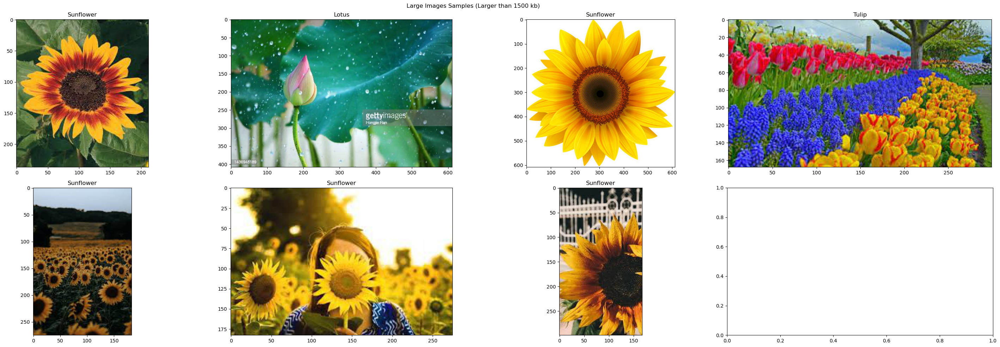

In [26]:
# Define the subplots for displaying images
fig, axes = plt.subplots(ncols=4, nrows= 2, figsize=(30,10))

# Saving the data to list
large_files = large_img_df['images'].to_list()
large_file_labels = large_img_df['label'].to_list()

# Iterate for every axes
idx = 0 # index to access the images and the label
for i in range(2):
    for j in range(4):
        if idx == 7:
            break
        img = plt.imread(large_files[idx])
        axes[i, j].imshow(img)
        axes[i, j].set_title(large_file_labels[idx])
        idx += 1

# Property of the plots
fig.suptitle('Large Images Samples (Larger than 1500 kb)')
fig.tight_layout()
plt.show()

We can observe that there are no specific characteristics apparent in the larger images. Therefore, we can infer that the larger size primarily indicates higher resolution rather than any distinctive features.

## Image Dimensions 

In [16]:
# Get all image dimensions
all_dimensions = []
all_widths = []
all_heights = []
for label in labels:
    files = files_dict[f'{label}_files']

    for i in range(len(files)):
        temp_path = files[i]
        dimension = (0,0)
        try:
            with Image.open(temp_path) as img:
                dimension = img.size
        except Exception as e:
            print(f"Error reading image {temp_path}: {e}")
        width, height = dimension[0], dimension[1]
        all_dimensions.append(dimension)
        all_widths.append(width)
        all_heights.append(height)

# Save the image dimensions to the image dataframe
img_df['dimensions'] = all_dimensions

img_df

,images,label,size_kb,dimensions
0,./flower_images/Lotus/Lotus_001.jpg,Lotus,33.908,"(361, 416)"
1,./flower_images/Lotus/Lotus_002.jpg,Lotus,11.568,"(195, 258)"
2,./flower_images/Lotus/Lotus_003.jpg,Lotus,51.821,"(500, 583)"
3,./flower_images/Lotus/Lotus_004.jpg,Lotus,6.453,"(225, 225)"
4,./flower_images/Lotus/Lotus_005.jpg,Lotus,176.365,"(1000, 825)"
...,...,...,...,...
4995,./flower_images/Sunflower/Sunflower_995.jpg,Sunflower,10.882,"(251, 201)"
4996,./flower_images/Sunflower/Sunflower_996.jpg,Sunflower,7.918,"(225, 225)"
4997,./flower_images/Sunflower/Sunflower_997.jpg,Sunflower,11.105,"(272, 185)"
4998,./flower_images/Sunflower/Sunflower_998.jpg,Sunflower,9.166,"(152, 331)"


In [17]:
# Saving the dimensions into dataframe
dimension_df = pd.DataFrame({
    'dimensions': all_dimensions,
    'width': all_widths,
    'height': all_heights
})

dimension_df

,dimensions,width,height
0,"(361, 416)",361,416
1,"(195, 258)",195,258
2,"(500, 583)",500,583
3,"(225, 225)",225,225
4,"(1000, 825)",1000,825
...,...,...,...
4995,"(251, 201)",251,201
4996,"(225, 225)",225,225
4997,"(272, 185)",272,185
4998,"(152, 331)",152,331


We've successfully extracted and saved the dimensions of the images.

### Width Distribution 

In [18]:
dimension_df['width'].describe().to_frame().T

,count,mean,std,min,25%,50%,75%,max
width,5000.0,505.2606,498.474678,101.0,245.0,284.0,607.0,4987.0


We observe that the mean width of the images is 505.2606 pixels, with the smallest width among the images being 101 pixels and the largest width 4987 pixels. This extensive difference indicates a wide variation in the resolutions of the image dataset.

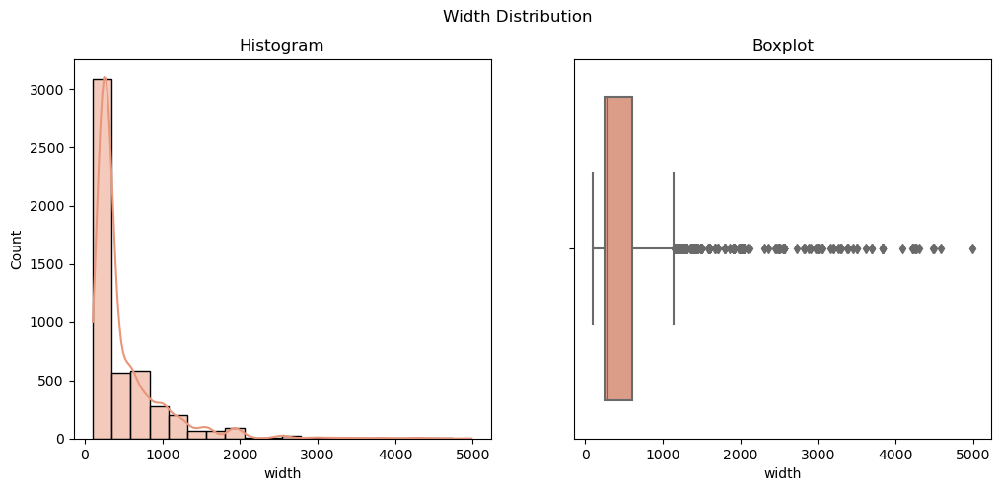

In [19]:
plot_distribution(dimension_df, 'width', 'Width', 'darksalmon')

As seen in the visualization, the width of the images follows a skewed distribution. There are quite a lot of outliers observed in the boxplot, indicating that several images have an extensive width compared to the overall dataset. The majority of image widths fall below 1000 pixels, which is considered sufficient and decent for training purposes.

### Height Distribution 

In [20]:
dimension_df['height'].describe().to_frame().T

,count,mean,std,min,25%,50%,75%,max
height,5000.0,424.4654,431.370233,113.0,183.0,252.5,466.0,4579.0


We observe that the mean height of the images is 424.4654 pixels, with the smallest height among the images being 113 pixels and the largest height 4579 pixels. This significant difference further supports the indication of a wide variation in the resolutions of the image dataset.

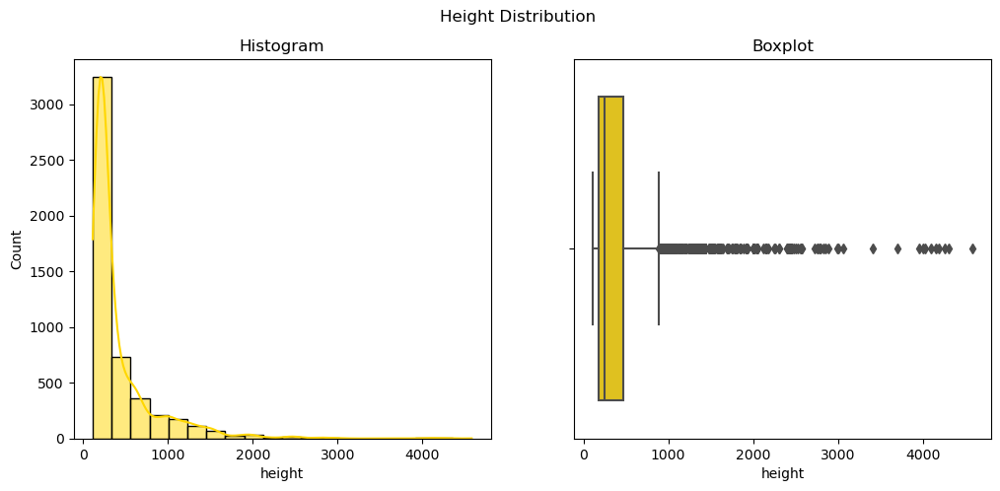

In [21]:
plot_distribution(dimension_df, 'height', 'Height', 'gold')

As seen in the visualization, the height of the images follows a skewed distribution. There are quite a lot of outliers observed in the boxplot, indicating that several images have an extensive height compared to the overall dataset. The majority of image heights fall below 1000 pixels, which is considered sufficient and decent for training purposes.

## Display Images

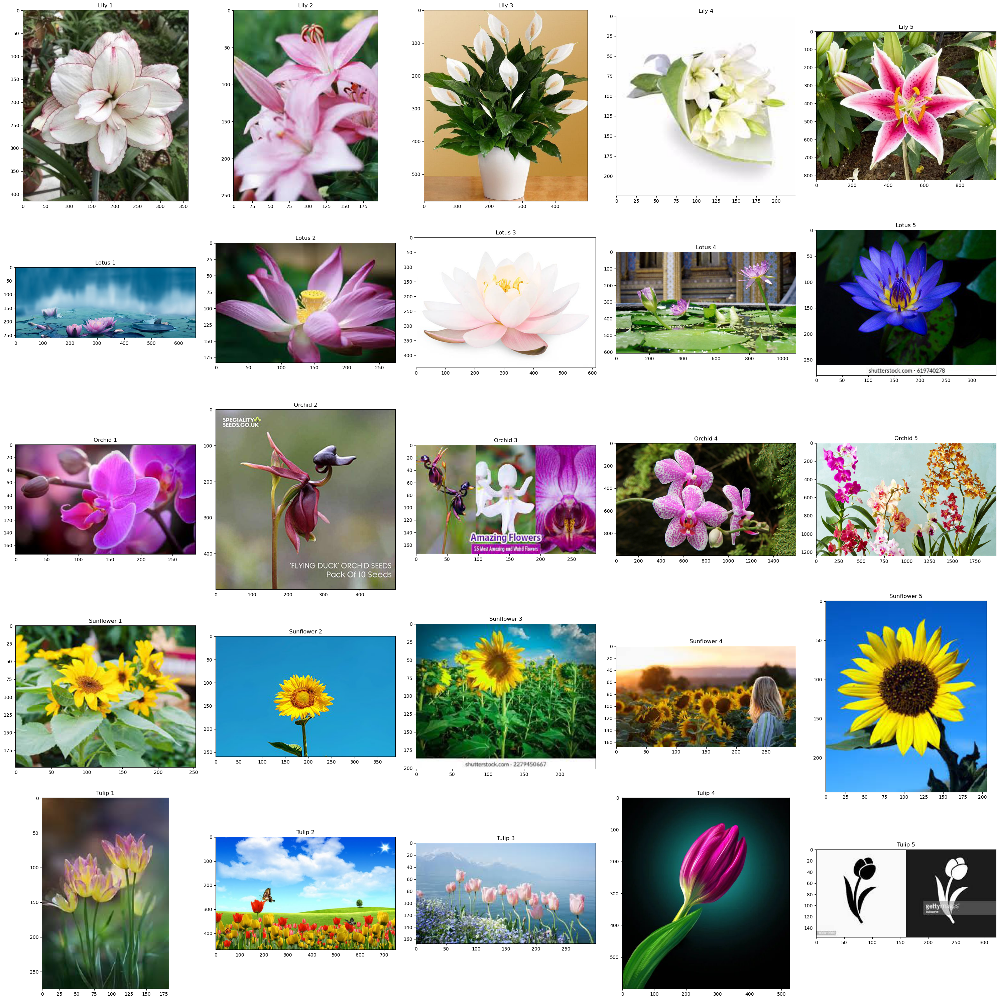

In [16]:
# Show preview images in each category

fig, axes = plt.subplots(ncols=5, nrows= 5, figsize=(30,30))

# Iterate over each label
for i in range(len(labels)):
    label = labels[i]
    # print(label)
    samples = files_dict[f'{label}_files'][:5]

    # Iterate over each sample for the current label
    for j in range(len(samples)):
        img = plt.imread(samples[j])
        axes[i, j].imshow(img)
        axes[i, j].set_title(f'{label} {j+1}')

fig.tight_layout()
plt.show()

We've successfully displayed the image data. We can see that the dataset consists of a multitude of variations such as different angles, color palettes, individual or clustered flowers, and varying levels of zoom present across the images.

In [33]:
# Saving the dataframe
dimension_df.to_csv('deployment/content/dimension.csv', index=False)
img_df.to_csv('deployment/content/img.csv', index=False)

# **Feature Engineering** 

## Split Train, Validation, and Test Set

In [22]:
# Randomize the order of the data
img_df = img_df.sample(len(img_df)).reset_index(drop=True)

img_df

,images,label,size_kb,dimensions
0,./flower_images/Tulip/Tulip_742.jpg,Tulip,8.047,"(183, 276)"
1,./flower_images/Lily/Lily_056.jpg,Lily,14.044,"(276, 183)"
2,./flower_images/Tulip/Tulip_521.jpg,Tulip,7.264,"(280, 180)"
3,./flower_images/Lily/Lily_782.jpg,Lily,11.112,"(176, 286)"
4,./flower_images/Orchid/Orchid_887.jpg,Orchid,14.034,"(369, 136)"
...,...,...,...,...
4995,./flower_images/Orchid/Orchid_094.jpg,Orchid,27.352,"(299, 168)"
4996,./flower_images/Sunflower/Sunflower_280.jpg,Sunflower,11.606,"(225, 225)"
4997,./flower_images/Lily/Lily_233.jpg,Lily,70.769,"(480, 720)"
4998,./flower_images/Lotus/Lotus_295.jpg,Lotus,28.080,"(333, 500)"


We've successfully shuffle the order of the data before splitting it into train, validation, and test set.

In [23]:
# Split into train + val and test set
train_df, dummy_df = train_test_split(img_df, test_size=0.3, random_state=123, stratify=img_df['label'])

# Split into train and val set
test_df, val_df = train_test_split(dummy_df, test_size=0.3, random_state=123, stratify=dummy_df['label'])

print(f'Train shape: {train_df.shape}')
print(f'Val shape: {val_df.shape}')
print(f'Test shape: {test_df.shape}')

Train shape: (3500, 4)
Val shape: (450, 4)
Test shape: (1050, 4)


We've successfully splitted the data into train, test, and validation sets.

In [24]:
# Get label proportion for each sets
labels, counts_train = label_proportion(train_df)
labels, counts_val = label_proportion(val_df)
labels, counts_test = label_proportion(test_df)

# Save the label proportion into a dataframe
label_proportion_df = pd.DataFrame({
    'label': labels,
    'train': counts_train,
    'val': counts_val,
    'test': counts_test,
})

label_proportion_df

,label,train,val,test
0,Lily,700,90,210
1,Lotus,700,90,210
2,Orchid,700,90,210
3,Sunflower,700,90,210
4,Tulip,700,90,210


We can see that the proportion for each labels in train, test, and validation sets are balanced.

## Image Data Generator

Found 3500 validated image filenames belonging to 5 classes.
Indices: {'Lily': 0, 'Lotus': 1, 'Orchid': 2, 'Sunflower': 3, 'Tulip': 4}


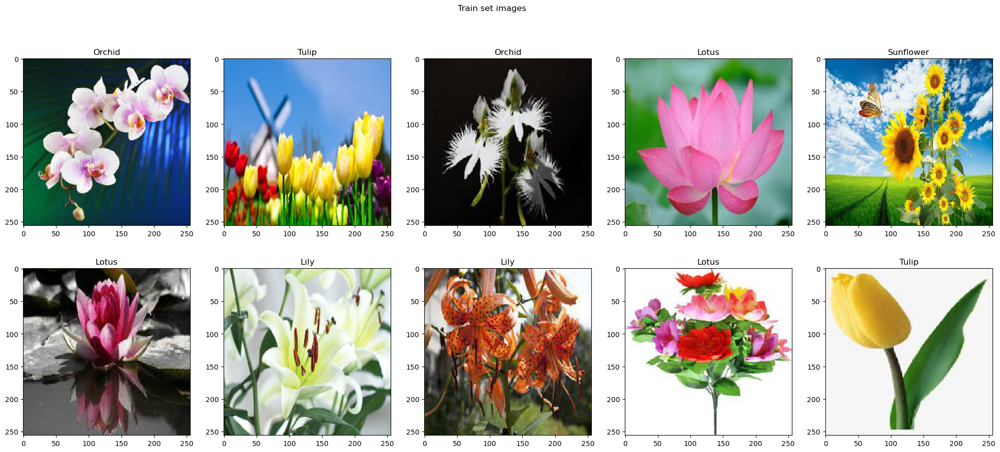

In [25]:
# Train Image Data Generator
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255.)

# Flow from dataframe
train_gen = train_datagen.flow_from_dataframe(
	  train_df,
    x_col='images',
    y_col='label',
    # target_size=(150, 150),
	  class_mode='categorical',
	  shuffle=False
)

label_indices = train_gen.class_indices
classes= list(label_indices.keys())

print(f'Indices: {label_indices}')

# Show images of train-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img, label = train_gen.next()
    idx = np.argmax(label, axis=1)  # Get the index of the maximum value in each label
    class_names = [classes[i] for i in idx]  # Get the class names for the corresponding indices
    
    # Display the image along with its label
    ax[i][j].imshow(img[0])  
    ax[i][j].set_title(class_names[0])

fig.suptitle('Train set images')
plt.show()

Now, we generate the image for train using the ImageDataGenerator. We've successfully rescaled the image and displayed the images in the train set. 

Found 450 validated image filenames belonging to 5 classes.
Indices: {'Lily': 0, 'Lotus': 1, 'Orchid': 2, 'Sunflower': 3, 'Tulip': 4}


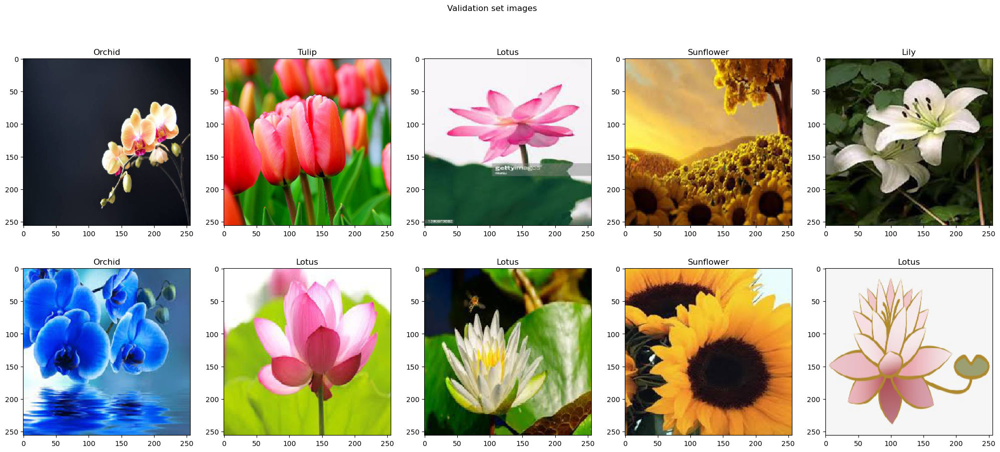

In [26]:
# Validation Image Data Generator
val_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255.)

# Flow from dataframe
val_gen = val_datagen.flow_from_dataframe(
	val_df,
    x_col='images',
    y_col='label',
    # target_size=(150, 150),
	class_mode='categorical',
	shuffle=False
)

label_indices = val_gen.class_indices
classes= list(label_indices.keys())

print(f'Indices: {label_indices}')

# Show images of val-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img, label = val_gen.next()
    idx = np.argmax(label, axis=1)  # Get the index of the maximum value in each label
    class_names = [classes[i] for i in idx]  # Get the class names for the corresponding indices
    
    # Display the image along with its label
    ax[i][j].imshow(img[0])  
    ax[i][j].set_title(class_names[0])

fig.suptitle('Validation set images')
plt.show()

Now, we generate the image for validation using the ImageDataGenerator. We've successfully rescaled the image and displayed the images in the validation set. 

Found 1050 validated image filenames belonging to 5 classes.
Indices: {'Lily': 0, 'Lotus': 1, 'Orchid': 2, 'Sunflower': 3, 'Tulip': 4}


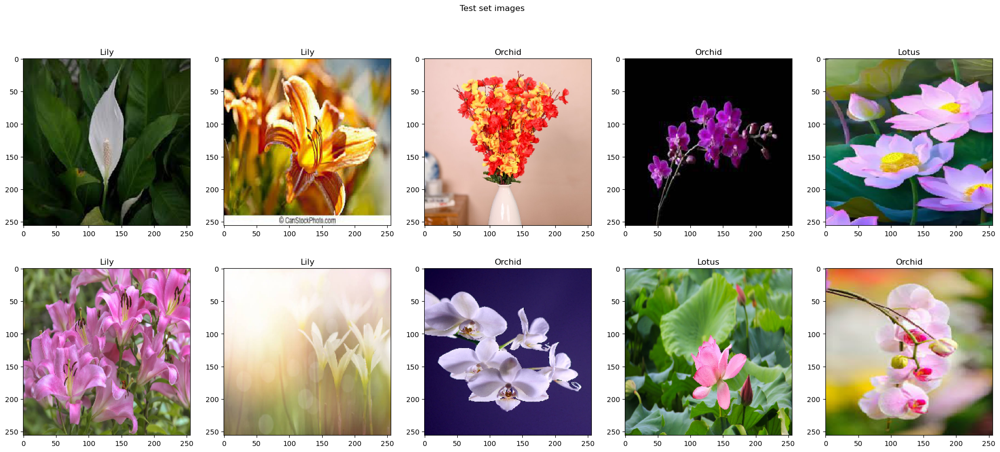

In [27]:
# Test Image Data Generator
test_datagen = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255.)

# Flow from dataframe
test_gen = test_datagen.flow_from_dataframe(
	  test_df,
    x_col='images',
    y_col='label',
    # target_size=(150, 150),
	  class_mode='categorical',
	  shuffle=False
)

label_indices = test_gen.class_indices
classes= list(label_indices.keys())

print(f'Indices: {label_indices}')

# Show images of test-set
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img, label = test_gen.next()
    idx = np.argmax(label, axis=1)  # Get the index of the maximum value in each label
    class_names = [classes[i] for i in idx]  # Get the class names for the corresponding indices
    
    # Display the image along with its label
    ax[i][j].imshow(img[0])  
    ax[i][j].set_title(class_names[0])

fig.suptitle('Test set images')
plt.show()

Now, we generate the image for test using the ImageDataGenerator. We've successfully rescaled the image and displayed the images in the test set. 

# **ANN Training**

## Model Definition 

In [23]:
# Clear Session
seed = 20
tf.keras.backend.clear_session()
np.random.seed(seed)
tf.random.set_seed(seed)

# Create Sequential API
model = tf.keras.models.Sequential()

# Convolution Layers
model.add(tf.keras.layers.Conv2D(
        filters= 32,
        kernel_size=(3, 3),
        activation='relu',
        input_shape=(256, 256, 3),
        name = 'input-convolution-layer-1'
    )
)
model.add(tf.keras.layers.MaxPooling2D(2, 2, name = 'pooling-layer-1'))
model.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu', name = 'convolution-layer-2'))
model.add(tf.keras.layers.MaxPooling2D(2, 2, name = 'pooling-layer-2'))
model.add(tf.keras.layers.Conv2D(128, (3, 3), activation='relu', name = 'convolution-layer-3'))
model.add(tf.keras.layers.MaxPooling2D(2, 2, name = 'pooling-layer-3'))
model.add(tf.keras.layers.GlobalMaxPooling2D(name = 'global-pooling-layer'))

# Hidden Dense Layers
model.add(tf.keras.layers.Dense(500, activation='relu', name = 'dense-layer-1'))
model.add(tf.keras.layers.Dense(400, activation='relu', name = 'dense-layer-2'))
model.add(tf.keras.layers.Dense(300, activation='relu', name = 'dense-layer-3'))
model.add(tf.keras.layers.Dense(200, activation='relu', name = 'dense-layer-4'))
model.add(tf.keras.layers.Dense(100, activation='relu', name = 'dense-layer-5'))

# Output Layer
model.add(tf.keras.layers.Dense(5, activation='softmax', name = 'output-layer'))

# Compile
model.compile(loss = 'categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input-convolution-layer-1   (None, 254, 254, 32)      896       
 (Conv2D)                                                        
                                                                 
 pooling-layer-1 (MaxPoolin  (None, 127, 127, 32)      0         
 g2D)                                                            
                                                                 
 convolution-layer-2 (Conv2  (None, 125, 125, 64)      18496     
 D)                                                              
                                                                 
 pooling-layer-2 (MaxPoolin  (None, 62, 62, 64)        0         
 g2D)                                                            
                                                                 
 convolution-layer-3 (Conv2  (None, 60, 60, 128)       7

We've successfully defined the model. The model is a Sequential CNN, consisting primarily of three main layers: Convolution Layers, Hidden Dense Layers, and the Output Layer. Convolution layers are used to apply filters across the input to extract relevant features and capture spatial patterns. These layers include Input, Convolution Layer 1, Pooling Layer 1, Convolution Layer 2, Pooling Layer 2, Convolution Layer 3, Pooling Layer 3, and finally, the Global Pooling Layer. Hidden dense layers perform nonlinear transformations on the input data to learn complex relationships between features, enabling the network to make predictions. Essentially, the hidden layers calculate the weights of each relationship to optimize predictions. In this model, there are five hidden dense layers with 500, 400, 300, 200, and 100 neurons, respectively. We use accuracy metrics as the label counts in the training data are balanced.

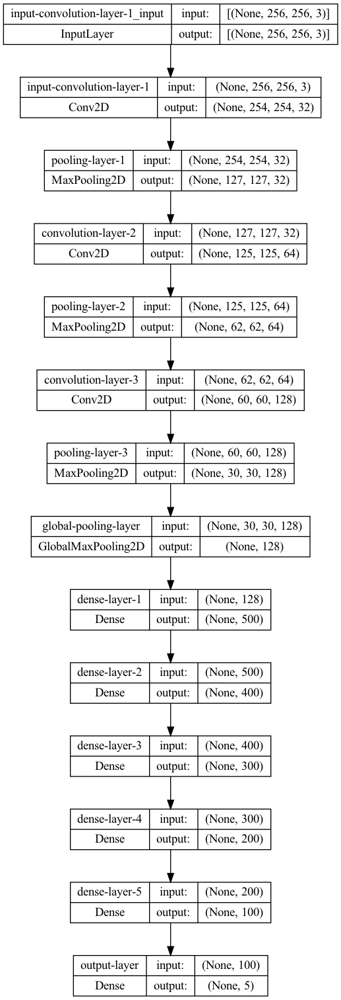

In [24]:
# Plot Layers

tf.keras.utils.plot_model(model, show_shapes=True)

We can see the visualization of the sequential CNN model.

## Model Training 

In [25]:
# Commented to prevent running again
history = model.fit(train_gen, epochs=30, steps_per_epoch = 50, validation_data = val_gen, verbose = 1, validation_steps=10)

Epoch 1/30
50/50 [==============================] - 37s 713ms/step - loss: 1.4619 - accuracy: 0.3250 - val_loss: 1.2894 - val_accuracy: 0.4187
Epoch 2/30
50/50 [==============================] - 35s 703ms/step - loss: 1.2959 - accuracy: 0.4162 - val_loss: 1.2707 - val_accuracy: 0.3656
Epoch 3/30
50/50 [==============================] - 34s 682ms/step - loss: 1.1792 - accuracy: 0.4938 - val_loss: 1.1449 - val_accuracy: 0.5219
Epoch 4/30
50/50 [==============================] - 34s 678ms/step - loss: 1.1102 - accuracy: 0.5418 - val_loss: 1.0482 - val_accuracy: 0.5813
Epoch 5/30
50/50 [==============================] - 34s 681ms/step - loss: 1.0470 - accuracy: 0.5612 - val_loss: 1.0009 - val_accuracy: 0.5875
Epoch 6/30
50/50 [==============================] - 34s 677ms/step - loss: 0.9427 - accuracy: 0.6219 - val_loss: 0.9830 - val_accuracy: 0.5938
Epoch 7/30
50/50 [==============================] - 34s 676ms/step - loss: 1.0210 - accuracy: 0.5950 - val_loss: 0.9502 - val_accuracy: 0.6125

We've successfully trained the model with 30 epochs, 50 steps per epoch, and 10 validation steps. As we can see, we get the loss, accuracy, validation loss, and validation accuracy values in each epoch.

## Model Evaluation 

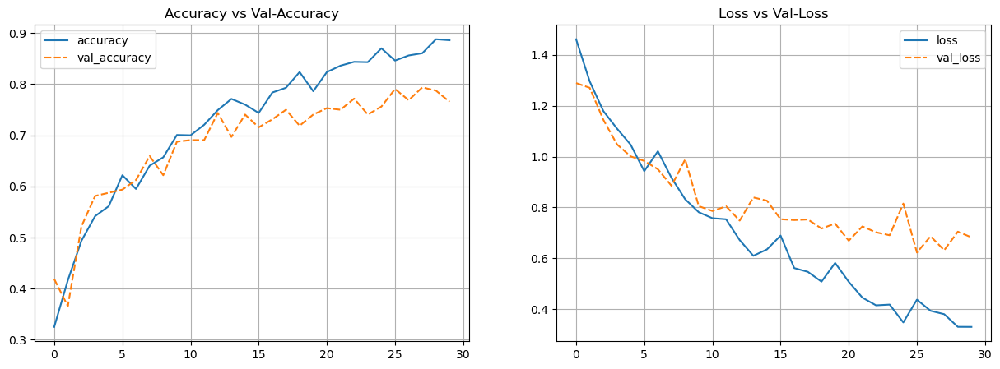

In [26]:
# Plot Training Results

history_df = pd.DataFrame(history.history)

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.lineplot(data=history_df[['accuracy', 'val_accuracy']])
plt.grid()
plt.title('Accuracy vs Val-Accuracy')

plt.subplot(1, 2, 2)
sns.lineplot(data=history_df[['loss', 'val_loss']])
plt.grid()
plt.title('Loss vs Val-Loss')
plt.show()

Based on the visualization, we can see that the validation accuracy mostly falls below the accuracy and the validation losses are significantly larger than the loss. This suggests that the model is exhibiting signs of overfitting, where it performs exceptionally well on the training data but struggles to generalize effectively to unseen validation sets.

In [27]:
# Evaluate the Model with Train sets
loss_train, accuracy_train = model.evaluate(train_gen)

# Print the evaluation results
print('Train Loss:', round(loss_train, 4))
print('Train Accuracy:', round(accuracy_train, 4))
print('-' * 50)

# Evaluate the Model with Validation sets
loss_val, accuracy_val = model.evaluate(val_gen)

# Print the evaluation results
print('Validation Loss:', round(loss_val, 4))
print('Validation Accuracy:', round(accuracy_val, 4))
print('-' * 50)

# Evaluate the Model with Test sets
loss_test, accuracy_test = model.evaluate(test_gen)

# Print the evaluation results
print('Test Loss:', round(loss_test, 4))
print('Test Accuracy:', round(accuracy_test, 4))
print('-' * 50)


110/110 [==============================] - 22s 199ms/step - loss: 0.3304 - accuracy: 0.8771
Train Loss: 0.3304
Train Accuracy: 0.8771
--------------------------------------------------
15/15 [==============================] - 3s 176ms/step - loss: 0.6204 - accuracy: 0.7733
Validation Loss: 0.6204
Validation Accuracy: 0.7733
--------------------------------------------------
33/33 [==============================] - 7s 193ms/step - loss: 0.6453 - accuracy: 0.7790
Test Loss: 0.6453
Test Accuracy: 0.779
--------------------------------------------------


Looking at the scores provided, the model performs well on the training set, achieving approximately 88% accuracy with a low loss score of 0.3. However, the validation set shows lower performance, with an accuracy of around 78% and a notably higher loss score of approximately 0.62. Similarly, the test set also gets an accuracy of approximately 78% with a loss score of 0.64. These results indicate that the model is overfitting, as it struggles to generalize to unseen data, evidenced by the lower performance on the validation and test sets. Despite this overfitting, the model still demonstrates decent accuracy in predicting unseen data, with an accuracy of around 78%.

33/33 [==============================] - 7s 193ms/step
              precision    recall  f1-score   support

        Lily       0.72      0.58      0.64       210
       Lotus       0.84      0.69      0.76       210
      Orchid       0.70      0.81      0.75       210
   Sunflower       0.93      0.98      0.96       210
       Tulip       0.72      0.84      0.77       210

    accuracy                           0.78      1050
   macro avg       0.78      0.78      0.78      1050
weighted avg       0.78      0.78      0.78      1050



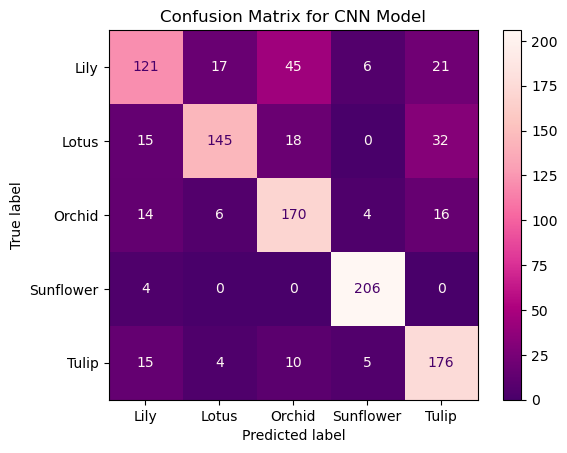

In [28]:
# Make predictions
predictions = model.predict(test_gen)

# Get the predicted class labels
predicted_labels = np.argmax(predictions, axis=1)

target = ['Lily', 'Lotus', 'Orchid', 'Sunflower', 'Tulip']
print(classification_report(test_gen.labels, predicted_labels, target_names = target))

# Compute confusion matrix
conf_matrix = confusion_matrix(test_gen.labels, predicted_labels)
display = ConfusionMatrixDisplay(conf_matrix, display_labels=list(test_gen.class_indices.keys()))
display.plot(cmap='RdPu_r')
plt.title('Confusion Matrix for CNN Model')

plt.show()

The test set accuracy of approximately 78% is considered decent. Analyzing the confusion matrix and F1 scores from the classification reports, we observe that the model excels in predicting sunflower images. However, it struggles with identifying lily images, achieving F1 scores of around 64%, likely due to the diverse variations within lily images and their similarity to other flower types. Additionally, the model exhibits stable and satisfactory performance in predicting orchid, lotus, and tulip images, achieving F1 scores ranging from 75% to 77%.

# **ANN Improvement**

## Model Definition 

Found 3500 validated image filenames belonging to 5 classes.
Indices: {'Lily': 0, 'Lotus': 1, 'Orchid': 2, 'Sunflower': 3, 'Tulip': 4}


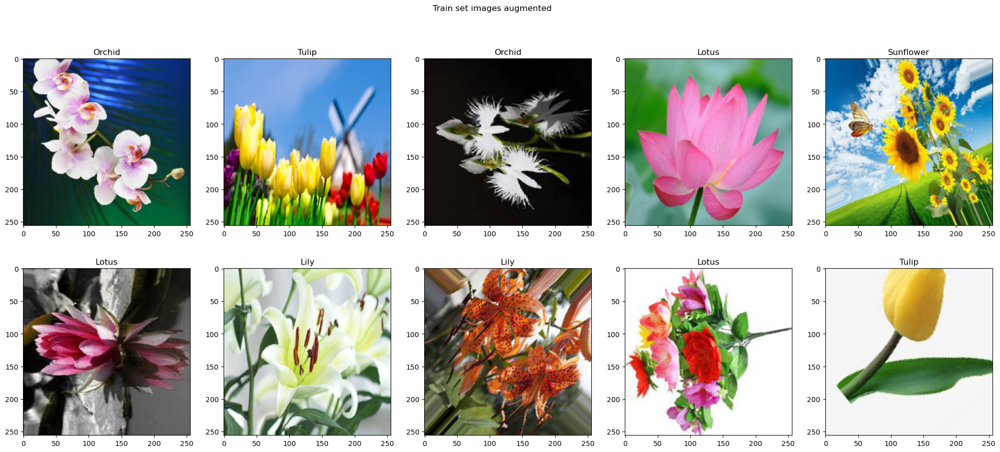

In [28]:
# Train Image Data Generator
train_datagen_aug = tf.keras.preprocessing.image.ImageDataGenerator(
  rescale=1./255.,
  horizontal_flip=True,
  rotation_range=120,
)

# Flow from dataframe
train_gen_aug = train_datagen_aug.flow_from_dataframe(
	  train_df,
    x_col='images',
    y_col='label',
    # target_size=(150, 150),
	  class_mode='categorical',
	  shuffle=False
)

label_indices = train_gen_aug.class_indices
classes= list(label_indices.keys())

print(f'Indices: {label_indices}')

# Show images of train-set augmented
fig, ax = plt.subplots(nrows=2, ncols=5, figsize=(25,10))
n = 0

for i in range(2):
  for j in range(5):
    img, label = train_gen_aug.next()
    idx = np.argmax(label, axis=1)  # Get the index of the maximum value in each label
    class_names = [classes[i] for i in idx]  # Get the class names for the corresponding indices
    
    # Display the image along with its label
    ax[i][j].imshow(img[0])  
    ax[i][j].set_title(class_names[0])

fig.suptitle('Train set images augmented')
plt.show()

To enhance the diversity of the images, we applied augmentation techniques such as rotating them up to 120 degrees and horizontally flipping them. The samples image displayed above demonstrates the successful augmentation of the training data. Through these augmentation techniques, we aim to improve the model's ability to generalize predictions across a wider range of image data.

In [29]:
# Clear Session
seed = 20
tf.keras.backend.clear_session()
np.random.seed(seed)
tf.random.set_seed(seed)

# Create Sequential API
model_improvement = tf.keras.models.Sequential()

# Convolution Layers
model_improvement.add(tf.keras.layers.Conv2D(
        filters= 32,
        kernel_size=(3, 3),
        activation='relu',
        input_shape=(256, 256, 3),
        name = 'input-convolution-layer-1'
    )
)
model_improvement.add(tf.keras.layers.BatchNormalization())
model_improvement.add(tf.keras.layers.MaxPooling2D(2, 2, name = 'pooling-layer-1'))
model_improvement.add(tf.keras.layers.Conv2D(64, (3, 3), activation='relu', name = 'convolution-layer-2'))
model_improvement.add(tf.keras.layers.BatchNormalization())
model_improvement.add(tf.keras.layers.MaxPooling2D(2, 2, name = 'pooling-layer-2'))
model_improvement.add(tf.keras.layers.Conv2D(128, (3, 3), activation='relu', name = 'convolution-layer-3'))
model_improvement.add(tf.keras.layers.MaxPooling2D(2, 2, name = 'pooling-layer-3'))
model_improvement.add(tf.keras.layers.GlobalMaxPooling2D(name = 'global-pooling-layer'))

# Dropout Layer
model_improvement.add(tf.keras.layers.Dropout(0.2, name = 'dropout-layer'))

# Hidden Dense Layers
model_improvement.add(tf.keras.layers.Dense(500, activation='relu', name = 'dense-layer-1'))
model_improvement.add(tf.keras.layers.Dense(400, activation='relu', name = 'dense-layer-2'))
model_improvement.add(tf.keras.layers.Dense(300, activation='relu', name = 'dense-layer-3'))
model_improvement.add(tf.keras.layers.Dense(200, activation='relu', name = 'dense-layer-4'))
model_improvement.add(tf.keras.layers.Dense(100, activation='relu', name = 'dense-layer-5'))

# Output Layer
model_improvement.add(tf.keras.layers.Dense(5, activation='softmax', name = 'output-layer'))

early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

# Compile
model_improvement.compile(loss = 'categorical_crossentropy', optimizer='Adam', metrics=['accuracy'])

model_improvement.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input-convolution-layer-1   (None, 254, 254, 32)      896       
 (Conv2D)                                                        
                                                                 
 batch_normalization (Batch  (None, 254, 254, 32)      128       
 Normalization)                                                  
                                                                 
 pooling-layer-1 (MaxPoolin  (None, 127, 127, 32)      0         
 g2D)                                                            
                                                                 
 convolution-layer-2 (Conv2  (None, 125, 125, 64)      18496     
 D)                                                              
                                                                 
 batch_normalization_1 (Bat  (None, 125, 125, 64)      2

To enhance the model's performance, we add two new layers: Batch Normalization and Dropout. Batch normalization layers normalize the input before passing it to the next layer, aiming to prevent overfitting observed in the initial model. Batch normalization aids in generalizing the model to unseen data by stabilizing the training process. However, one drawback of batch normalization is a potential decrease in model accuracy, as the inputs become more generalized. To further combat overfitting, we incorporated Dropout layers, which deactivate unnecessary neurons during training to reduce training time. Additionally, we implemented early stopping to optimize the training process.

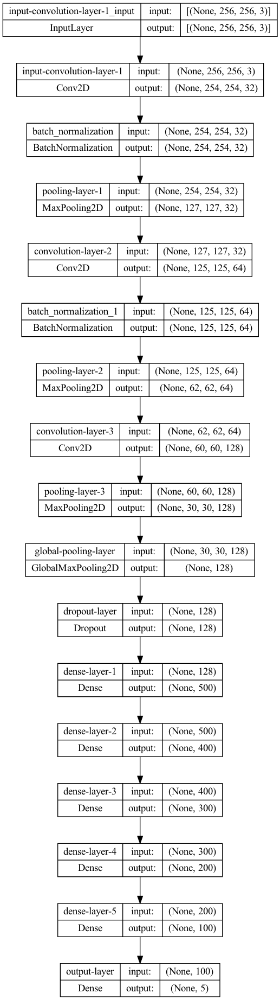

In [30]:
# Plot Layers

tf.keras.utils.plot_model(model_improvement, show_shapes=True)

We can see the visualization of the sequential improved CNN model.

## Model Training 

In [31]:
history_improvement = model_improvement.fit(train_gen_aug, epochs=30, steps_per_epoch = 50, validation_data = val_gen, verbose = 1, validation_steps=10, callbacks=[early_stopping])

Epoch 1/30
50/50 [==============================] - 46s 892ms/step - loss: 1.3755 - accuracy: 0.4152 - val_loss: 1.5763 - val_accuracy: 0.2719
Epoch 2/30
50/50 [==============================] - 46s 907ms/step - loss: 1.2263 - accuracy: 0.5056 - val_loss: 1.4085 - val_accuracy: 0.5312
Epoch 3/30
50/50 [==============================] - 45s 898ms/step - loss: 1.1452 - accuracy: 0.5222 - val_loss: 1.3425 - val_accuracy: 0.4469
Epoch 4/30
50/50 [==============================] - 45s 900ms/step - loss: 1.0901 - accuracy: 0.5562 - val_loss: 1.3462 - val_accuracy: 0.4531
Epoch 5/30
50/50 [==============================] - 44s 880ms/step - loss: 1.0525 - accuracy: 0.5690 - val_loss: 1.2659 - val_accuracy: 0.5562
Epoch 6/30
50/50 [==============================] - 44s 881ms/step - loss: 1.0459 - accuracy: 0.5848 - val_loss: 1.2237 - val_accuracy: 0.5344
Epoch 7/30
50/50 [==============================] - 45s 894ms/step - loss: 1.0206 - accuracy: 0.6087 - val_loss: 1.0952 - val_accuracy: 0.5531

We've successfully trained the model with 30 epochs, 50 steps per epoch, and 10 validation steps. Throughout the training process, we monitored the loss, accuracy, validation loss, and validation accuracy values for each epoch. Additionally, we implemented the early stopping callback, which will halt the training before reaching the 30th epoch if convergence criteria were met. However, since the convergence criteria were not met during the fitting process, the model continued training until it reached the 30th epoch.

## Model Evaluation

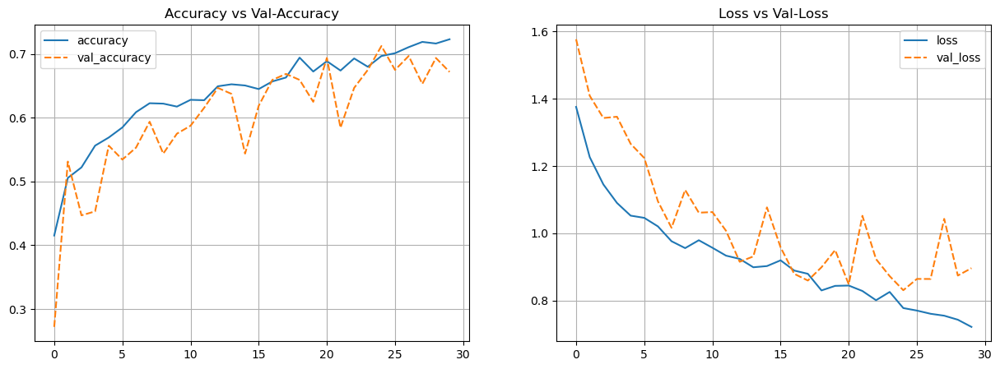

In [32]:
# Plot Training Results

history_improvement_df = pd.DataFrame(history_improvement.history)

plt.figure(figsize=(15, 5))
plt.subplot(1, 2, 1)
sns.lineplot(data=history_improvement_df[['accuracy', 'val_accuracy']])
plt.grid()
plt.title('Accuracy vs Val-Accuracy')

plt.subplot(1, 2, 2)
sns.lineplot(data=history_improvement_df[['loss', 'val_loss']])
plt.grid()
plt.title('Loss vs Val-Loss')
plt.show()

The improved model appears to be more stable than the previous model. We can see that the majority of the validation accuracy and loss performs similarly with the train set. But, the issue is the accuracy scores achieved decreases a lot. 

In [33]:
# Evaluate the Model with Train Augmented sets
loss_train_aug, accuracy_train_aug = model_improvement.evaluate(train_gen_aug)

# Print the evaluation results
print('Train Augmented Improved Loss:', round(loss_train_aug, 4))
print('Train Augmented Improved Accuracy:', round(accuracy_train_aug, 4))
print('-' * 50)

# Evaluate the Model with Validation Improved sets
loss_val, accuracy_val = model_improvement.evaluate(val_gen)

# Print the evaluation results
print('Validation Improved Loss:', round(loss_val, 4))
print('Validation Improved Accuracy:', round(accuracy_val, 4))
print('-' * 50)

# Evaluate the Model with Test Improved sets
loss_test, accuracy_test = model_improvement.evaluate(test_gen)

# Print the evaluation results
print('Test Improved Loss:', round(loss_test, 4))
print('Test Improved Accuracy:', round(accuracy_test, 4))
print('-' * 50)


110/110 [==============================] - 36s 322ms/step - loss: 0.7044 - accuracy: 0.7211
Train Augmented Improved Loss: 0.7044
Train Augmented Improved Accuracy: 0.7211
--------------------------------------------------
15/15 [==============================] - 3s 207ms/step - loss: 0.8498 - accuracy: 0.6778
Validation Improved Loss: 0.8498
Validation Improved Accuracy: 0.6778
--------------------------------------------------
33/33 [==============================] - 7s 218ms/step - loss: 0.7752 - accuracy: 0.6895
Test Improved Loss: 0.7752
Test Improved Accuracy: 0.6895
--------------------------------------------------


As we can see, the improved model is a lot more stable than the first model because the scores from train, test, and validation is in the same range and the difference isn't  significant. But, the loss value is a lot higher (around 0.7-0.8) and the accuracy decreases significantly to 68-69%.  it is evident that this model performs significantly worse compared to the previous model.

33/33 [==============================] - 8s 230ms/step
              precision    recall  f1-score   support

        Lily       0.60      0.53      0.56       210
       Lotus       0.60      0.70      0.64       210
      Orchid       0.61      0.82      0.70       210
   Sunflower       0.90      0.96      0.93       210
       Tulip       0.82      0.44      0.58       210

    accuracy                           0.69      1050
   macro avg       0.71      0.69      0.68      1050
weighted avg       0.71      0.69      0.68      1050



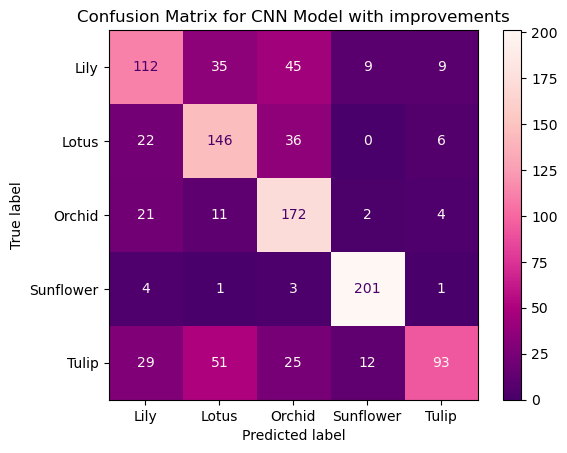

In [34]:
# Make predictions
predictions_improvement = model_improvement.predict(test_gen)

# Get the predicted class labels
predicted_improvements_labels = np.argmax(predictions_improvement, axis=1)

target = ['Lily', 'Lotus', 'Orchid', 'Sunflower', 'Tulip']
print(classification_report(test_gen.labels, predicted_improvements_labels, target_names = target))

# Compute confusion matrix
conf_matrix_improvements = confusion_matrix(test_gen.labels, predicted_improvements_labels)
display = ConfusionMatrixDisplay(conf_matrix_improvements, display_labels=list(test_gen.class_indices.keys()))
display.plot(cmap='RdPu_r')
plt.title('Confusion Matrix for CNN Model with improvements')

plt.show()

The test set accuracy of approximately 69% indicates moderate performance. Analyzing the confusion matrix and F1 scores from the classification reports, we find that the model excels in predicting sunflower images but struggles with identifying lily and tulip images, achieving F1 scores of only 56% and 58% respectively. Additionally, the model demonstrates moderate performance in predicting lotus and orchid images, with F1 scores of 64% and 70% respectively. Overall, despite its moderate performance, the first model still outperforms this model.

# **Model Saving** 

In [38]:
# Save the best model
model.save('deployment/base_model.keras')

Based on the evaluation of the two model, the best performing model is the base CNN sequential model. It has an accuracy score of 78% and loss score of 0.6. One drawbacks of the model is that the model is overfits but it's still acceptable as the difference between the train, validation, and test set achieved is not that significant.

# **Conclusion** 

- **EDA**  
The image dataset consists of five flower labels: Lily, Lotus, Orchid, Sunflower, and Tulip, each accounting for 20% of the total. Image sizes in the dataset vary considerably, with an extensive difference between the minimum and maximum sizes. However, both small and large images lack distinct characteristics, suggesting that the variation is primarily due to image resolution. The mean width and height of the images are 505.26 pixels and 424.46 pixels, respectively, which are sufficient for training purposes. The dataset exhibits a wide range of variations, including different angles, color palettes, and individual or clustered flowers, making it suitable for computer vision tasks due to its diverse representation of images.

- **Model**  
The base CNN sequential model is chosen as the best-performing model, achieving an accuracy score of 78% and a loss score of approximately 0.6. Although the model tends to overfit, the performance difference between the training, validation, and test sets is not that significant. The model excels at predicting sunflower images. We can infer this due to their distinct characteristics. However, it struggles to predict lily images accurately, likely due to their diverse variations and similarity to other flower types. Performance on other flower types (lotus, orchid, and tulip) remains stable and has a moderate performance, with F1 scores ranging from 75% to 77%.

- **Further Improvement**  
To enhance the model performance further, additional models could be trained with different parameters or CNN structures. Transfer learning may also be used to increase the performance using the pre-trained model. We can also improve the model by improving the dataset. We can augment the dataset with more diverse images, such as photos featuring individuals holding flowers. As it could also enhance the model's ability to generalize and predict a broader range of images accurately.